In [1]:
import matplotlib.pyplot as plt
import numpy as np


<AxesSubplot:xlabel='carat', ylabel='price'>

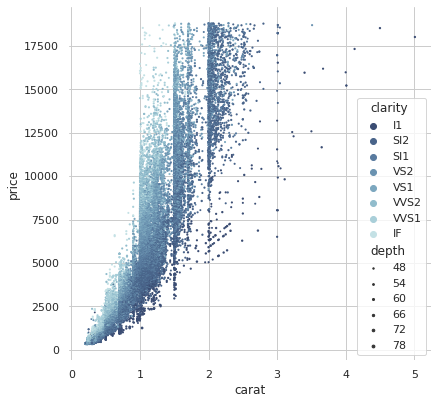

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="whitegrid")

# Load the example diamonds dataset
diamonds = sns.load_dataset("diamonds")

# Draw a scatter plot while assigning point colors and sizes to different
# variables in the dataset
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.despine(f, left=True, bottom=True)
clarity_ranking = ["I1", "SI2", "SI1", "VS2", "VS1", "VVS2", "VVS1", "IF"]
sns.scatterplot(x="carat", y="price",
                hue="clarity", size="depth",
                palette="ch:r=-.2,d=.3_r",
                hue_order=clarity_ranking,
                sizes=(1, 8), linewidth=0,
                data=diamonds, ax=ax)


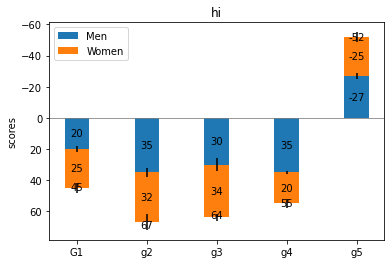

In [22]:
N = 5
menMeans = (20, 35, 30, 35, -27)
womenMeans = (25, 32, 34, 20, -25)
menStd = (2, 3, 4, 1, 2)
womenStd = (3, 5, 2, 3, 3)
ind = np.arange(N)    # the x locations for the groups
width = 0.35       # the width of the bars: can also be len(x) sequence

fig, ax = plt.subplots()
p1 = ax.bar(ind,menMeans,width,yerr=menStd,label = 'Men')
p2 = ax.bar(ind, womenMeans, width, bottom=menMeans, yerr=womenStd, label='Women')
ax.axhline(0,color='grey',linewidth=0.8)
ax.set_ylabel('scores')
ax.set_title('hi')
ax.set_xticks(ind)
ax.set_xticklabels(('G1','g2','g3','g4','g5'))
ax.legend()
ax.bar_label(p1,label_type='center')
ax.bar_label(p2,label_type='center')
ax.bar_label(p2)
ax.invert_yaxis()

Text(0.5, 0, 'x')

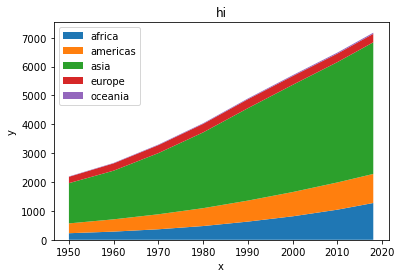

In [26]:
year = [1950, 1960, 1970, 1980, 1990, 2000, 2010, 2018]
population_by_continent = {
    'africa': [228, 284, 365, 477, 631, 814, 1044, 1275],
    'americas': [340, 425, 519, 619, 727, 840, 943, 1006],
    'asia': [1394, 1686, 2120, 2625, 3202, 3714, 4169, 4560],
    'europe': [220, 253, 276, 295, 310, 303, 294, 293],
    'oceania': [12, 15, 19, 22, 26, 31, 36, 39],
}

fig, ax = plt.subplots()
ax.stackplot(year,population_by_continent.values(),labels=population_by_continent.keys())
ax.legend(loc='upper left')
ax.set_title('hi')
ax.set_ylabel('y')
ax.set_xlabel('x')

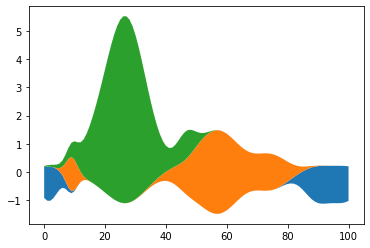

In [33]:
# Fixing random state for reproducibility
np.random.seed(19680801)


def gaussian_mixture(x, n=5):
    """Return a random mixture of *n* Gaussians, evaluated at positions *x*."""
    def add_random_gaussian(a):
        amplitude = 1 / (.1 + np.random.random())
        dx = x[-1] - x[0]
        x0 = (2 * np.random.random() - .5) * dx
        z = 10 / (.1 + np.random.random()) / dx
        a += amplitude * np.exp(-(z * (x - x0))**2)
    a = np.zeros_like(x)
    for j in range(n):
        add_random_gaussian(a)
    return a

x = np.linspace(0,100,101)
ys = [gaussian_mixture(x) for _ in range(3)]
fig, ax = plt.subplots()
ax.stackplot(x,ys, baseline='wiggle')

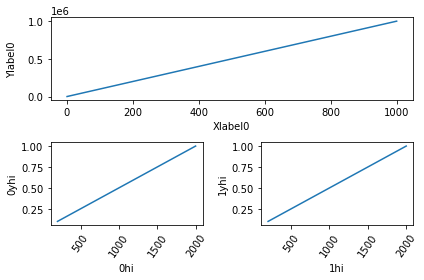

In [55]:
import matplotlib.gridspec as gridspec

fig = plt.figure(tight_layout=True)
gs = gridspec.GridSpec(2,2)
ax = fig.add_subplot(gs[0,:])
ax.plot(np.arange(0,1e6,1000))
ax.set_xlabel('Xlabel0')
ax.set_ylabel('Ylabel0')

for i in range(2):
    ax = fig.add_subplot(gs[1,i])
    ax.plot(np.arange(1,0,-.1)* 2000, np.arange(1,0,-.1))
    ax.set_xlabel(f'{i}hi')
    ax.set_ylabel(f'{i}yhi')
    for tick in ax.get_xticklabels():
        tick.set_rotation(55)
fig.align_labels()

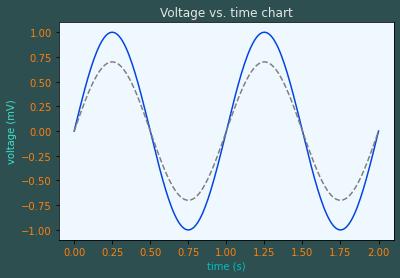

In [65]:
import matplotlib.pyplot as plt
import numpy as np

t = np.linspace(0.0, 2.0, 201)
s = np.sin(2 * np.pi * t)

# 1) RGB tuple:
fig, ax = plt.subplots(facecolor=(.18, .31, .31))
# 2) hex string:
ax.set_facecolor('aliceblue')
# 3) gray level string:
ax.set_title('Voltage vs. time chart', color='0.9')
# 4) single letter color string
ax.set_xlabel('time (s)', color='c')
# 5) a named color:
ax.set_ylabel('voltage (mV)', color='turquoise')
# 6) a named xkcd color:
ax.plot(t, s, 'xkcd:blue')
# 7) Cn notation:
ax.plot(t, .7*s, color='C7', linestyle='--')
# 8) tab notation:
ax.tick_params(labelcolor='tab:orange')


plt.show()

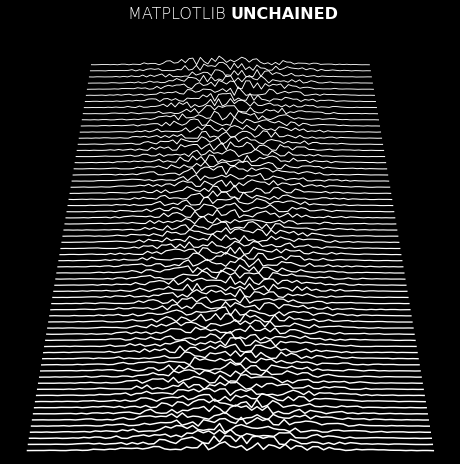

In [66]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Fixing random state for reproducibility
np.random.seed(19680801)


# Create new Figure with black background
fig = plt.figure(figsize=(8, 8), facecolor='black')

# Add a subplot with no frame
ax = plt.subplot(frameon=False)

# Generate random data
data = np.random.uniform(0, 1, (64, 75))
X = np.linspace(-1, 1, data.shape[-1])
G = 1.5 * np.exp(-4 * X ** 2)

# Generate line plots
lines = []
for i in range(len(data)):
    # Small reduction of the X extents to get a cheap perspective effect
    xscale = 1 - i / 200.
    # Same for linewidth (thicker strokes on bottom)
    lw = 1.5 - i / 100.0
    line, = ax.plot(xscale * X, i + G * data[i], color="w", lw=lw)
    lines.append(line)

# Set y limit (or first line is cropped because of thickness)
ax.set_ylim(-1, 70)

# No ticks
ax.set_xticks([])
ax.set_yticks([])

# 2 part titles to get different font weights
ax.text(0.5, 1.0, "MATPLOTLIB ", transform=ax.transAxes,
        ha="right", va="bottom", color="w",
        family="sans-serif", fontweight="light", fontsize=16)
ax.text(0.5, 1.0, "UNCHAINED", transform=ax.transAxes,
        ha="left", va="bottom", color="w",
        family="sans-serif", fontweight="bold", fontsize=16)


def update(*args):
    # Shift all data to the right
    data[:, 1:] = data[:, :-1]

    # Fill-in new values
    data[:, 0] = np.random.uniform(0, 1, len(data))

    # Update data
    for i in range(len(data)):
        lines[i].set_ydata(i + G * data[i])

    # Return modified artists
    return lines

# Construct the animation, using the update function as the animation director.
anim = animation.FuncAnimation(fig, update, interval=10)
plt.show()


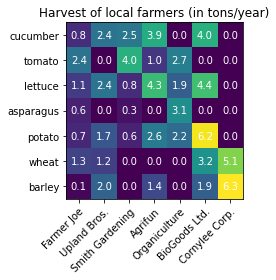

In [80]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

vegetables = ["cucumber", "tomato", "lettuce", "asparagus",
              "potato", "wheat", "barley"]
farmers = ["Farmer Joe", "Upland Bros.", "Smith Gardening",
           "Agrifun", "Organiculture", "BioGoods Ltd.", "Cornylee Corp."]

harvest = np.array([[0.8, 2.4, 2.5, 3.9, 0.0, 4.0, 0.0],
                    [2.4, 0.0, 4.0, 1.0, 2.7, 0.0, 0.0],
                    [1.1, 2.4, 0.8, 4.3, 1.9, 4.4, 0.0],
                    [0.6, 0.0, 0.3, 0.0, 3.1, 0.0, 0.0],
                    [0.7, 1.7, 0.6, 2.6, 2.2, 6.2, 0.0],
                    [1.3, 1.2, 0.0, 0.0, 0.0, 3.2, 5.1],
                    [0.1, 2.0, 0.0, 1.4, 0.0, 1.9, 6.3]])

fig, ax = plt.subplots()
im = ax.imshow(harvest)
ax.set_xticks(np.arange(len(farmers)))
ax.set_yticks(np.arange(len(vegetables)))
ax.set_xticklabels(farmers)
ax.set_yticklabels(vegetables)
plt.setp(ax.get_xticklabels(),rotation=45,ha='right',rotation_mode='anchor')
for i in range(len(farmers)):
    for j in range(len(vegetables)):
        text =  ax.text(j, i, harvest[i,j],ha='center',va='center',color='w')
ax.set_title("Harvest of local farmers (in tons/year)")
fig.tight_layout()
        

NameError: name 'true' is not defined

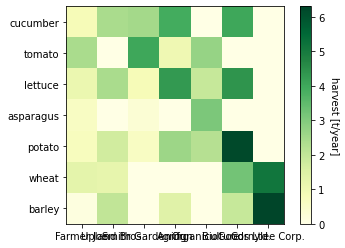

In [82]:
def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw={}, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.

    Parameters
    ----------
    data
        A 2D numpy array of shape (N, M).
    row_labels
        A list or array of length N with the labels for the rows.
    col_labels
        A list or array of length M with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """

    if not ax:
        ax = plt.gca()
    
    # plot the heatmap
    im = ax.imshow(data, **kwargs)

    # create colorbar
    cbar = ax.figure.colorbar(im,ax=ax,**cbar_kw)
    cbar.ax.set_ylabel(cbarlabel,rotation=-90,va='bottom')

    # Show all ticks
    ax.set_xticks(np.arange(data.shape[1]))
    ax.set_yticks(np.arange(data.shape[0]))
    # label them with list entries
    ax.set_xticklabels(col_labels)
    ax.set_yticklabels(row_labels)

    # horizontal axes labels appear on top 
    ax.tick_params(top=true,bottom=False,labeltop=True,labelbottom=False)

    
    plt.setp(ax.get_xticklabels(), rotation=-30,ha='right',rotation_mode='anchor')

    # turn spines off and create whitegrid
    ax.spines[:].set_visible(False)
    ax.set_xticks(np.arange(data.shape[1]+1)-0.5, minor = True)
    ax.set_yticks(np.arange(data.shape[0]+1)-0.5, minor = True)
    ax.grid(which='minor',color='w',linestyle='-',linewidth=2)
    ax.tick_params(which='minor',bottom=False,left=False)
    return im, cbar

def annotate_heatmap(im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list,np.ndarray)):
        data = im.get_array()
    
    # Normalize the the threshold image color range
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max() ) / 2
    
    kw = dict(horizontalalignment='center',verticalalignment='center')
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt,str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)
    
    # Loop over the data and create a string for each pixel
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i,j]) > threshold)])
            text = im.axes.text(j, i, valfmt(data[i,j],None),**kw)
            texts.append(text)
    return texts

fig, ax = plt.subplots()

im, cbar = heatmap(harvest, vegetables, farmers, ax=ax,
                   cmap="YlGn", cbarlabel="harvest [t/year]")

In [10]:
import numpy as np
from numpy.core.umath_tests import matrix_multiply as mm
from scipy.optimize import minimize
from scipy.stats import bernoulli, binom

np.random.seed(1234)
np.set_printoptions(formatter={'all':lambda x: '%.3f' % x})

/tmp/ipykernel_2499123/1428529945.py:2: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import matrix_multiply as mm


/home/mladen/anaconda3/envs/pytorch/lib/python3.9/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/mladen/anaconda3/envs/pytorch/lib/python3.9/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/mladen/anaconda3/envs/pytorch/lib/python3.9/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/mladen/anaconda3/envs/pytorch/lib/python3.9/site-p

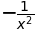

In [7]:
from sympy import symbols, diff, log, init_printing
x = symbols('x')
diff(log(x), x, 2)

In [11]:
def neg_loglik(thetas, n, xs, zs):
    return -np.sum([binom(n, thetas[z]).logpmf(x) for (x, z) in zip(xs, zs)])
m = 10
theta_A = 0.8
theta_B = 0.3
theta_0 = [theta_A, theta_B]

coin_A = bernoulli(theta_A)
coin_B = bernoulli(theta_B)

flips = np.array([coin_A.rvs(m),
                  coin_A.rvs(m),
                  coin_B.rvs(m),
                  coin_A.rvs(m),
                  coin_B.rvs(m)])
xs = flips.sum(1)
zs = np.array([0,0,1,0,1])
list(xs)

[7, 9, 2, 6, 0]

In [18]:
np.mean(xs[zs==0]/m)
np.mean(xs[zs==1]/m)
bnds = [(0,1), (0,1)]
minimize(neg_loglik, [0.5, 0.5], args=(m, xs, zs),
         bounds=bnds, method='tnc', options={'maxiter': 1000})



     fun: 7.655267754134089
     jac: array([-0.000, -0.000])
 message: 'Converged (|f_n-f_(n-1)| ~= 0)'
    nfev: 72
     nit: 8
  status: 1
 success: True
       x: array([0.733, 0.100])

In [19]:


def mn_ll(y, theta, axis=None):
    """Log likelihood for multinomial distribution (ignoring constant)."""
    return np.sum(y * np.log(theta), axis=axis)

def ll(y, theta, p):
    """Complete log likelihood for mixture."""
    return np.sum(p * mm_ll(y, theta))

def normalize(xs, axis=1):
    """Return normalized marirx so that sum of row or column (default) entries = 1."""
    if axis==0:
        return xs/xs.sum(0)
    else:
        return xs/xs.sum(1)[:, None]



array([[0.797, 0.203],
       [0.520, 0.480]])

In [20]:
xs = np.array([(5,5), (9,1), (8,2) , (4,6), (7,3)])
thetas = np.array([[0.6, 0.4], [0.5, 0.5]])

tol = 0.01
max_iter = 100

ll_old = 0
for i in range(max_iter):
    exp_A = []
    exp_B = []

    lls_A = []
    lls_B = []

    ws_A = []
    ws_B = []

    ll_new = 0

    # E-step: calculate probability distributions over possible completions
    for x in xs:

        ll_A = mn_ll(x, thetas[0])
        ll_B = mn_ll(x, thetas[1])

        lls_A.append(ll_A)
        lls_B.append(ll_B)

        denom = np.exp(ll_A) + np.exp(ll_B)
        w_A = np.exp(ll_A)/denom
        w_B = np.exp(ll_B)/denom

        ws_A.append(w_A)
        ws_B.append(w_B)

        exp_A.append(np.dot(w_A, x))
        exp_B.append(np.dot(w_B, x))

        # update complete log likelihood
        ll_new += w_A * ll_A + w_B * ll_B

    # M-step: update values for parameters given current distribution
    thetas[0] = np.sum(exp_A, 0)/np.sum(exp_A)
    thetas[1] = np.sum(exp_B, 0)/np.sum(exp_B)

    # print distribution of z for each x and current parameter estimate
    print("Iteration: %d" % (i+1))
    print("theta_A = %.2f, theta_B = %.2f, ll = %.2f" % (thetas[0,0], thetas[1,0], ll_new))

    if np.abs(ll_new - ll_old) < tol:
        break
    ll_old = ll_new

Iteration: 1
theta_A = 0.71, theta_B = 0.58, ll = -32.69
Iteration: 2
theta_A = 0.75, theta_B = 0.57, ll = -31.26
Iteration: 3
theta_A = 0.77, theta_B = 0.55, ll = -30.76
Iteration: 4
theta_A = 0.78, theta_B = 0.53, ll = -30.33
Iteration: 5
theta_A = 0.79, theta_B = 0.53, ll = -30.07
Iteration: 6
theta_A = 0.79, theta_B = 0.52, ll = -29.95
Iteration: 7
theta_A = 0.80, theta_B = 0.52, ll = -29.90
Iteration: 8
theta_A = 0.80, theta_B = 0.52, ll = -29.88
Iteration: 9
theta_A = 0.80, theta_B = 0.52, ll = -29.87


In [23]:
xs = np.array([(5,5), (9,1), (8,2), (4,6), (7,3)])
thetas = np.array([[0.6, 0.4], [0.5, 0.5]])

tol = 0.01
max_iter = 100

ll_old = -np.infty
for i in range(max_iter):
    ll_A = np.sum(xs * np.log(thetas[0]), axis=1)
    ll_B = np.sum(xs * np.log(thetas[1]), axis=1)
    denom = np.exp(ll_A) + np.exp(ll_B)
    w_A = np.exp(ll_A)/denom
    w_B = np.exp(ll_B)/denom

    exp_A = w_A[:, None] * xs
    exp_B = w_B[:, None] * xs

    thetas[0] = np.sum(exp_A, 0)/np.sum(exp_A)
    thetas[1] = np.sum(exp_B, 0)/np.sum(exp_B)

    ll_new = w_A.dot(ll_A) + w_B.dot(ll_B)

    print("Iteration: %d" % (i+1))
    print("theta_A = %.2f, theta_B = %.2f, ll = %.2f" % (thetas[0,0], thetas[1,0], ll_new))

    if np.abs(ll_new - ll_old) < tol:
        break
    ll_old = ll_new

Iteration: 1
theta_A = 0.71, theta_B = 0.58, ll = -32.69
Iteration: 2
theta_A = 0.75, theta_B = 0.57, ll = -31.26
Iteration: 3
theta_A = 0.77, theta_B = 0.55, ll = -30.76
Iteration: 4
theta_A = 0.78, theta_B = 0.53, ll = -30.33
Iteration: 5
theta_A = 0.79, theta_B = 0.53, ll = -30.07
Iteration: 6
theta_A = 0.79, theta_B = 0.52, ll = -29.95
Iteration: 7
theta_A = 0.80, theta_B = 0.52, ll = -29.90
Iteration: 8
theta_A = 0.80, theta_B = 0.52, ll = -29.88
Iteration: 9
theta_A = 0.80, theta_B = 0.52, ll = -29.87


In [24]:
def em(xs, thetas, max_iter=100, tol=1e-6):
    """Expectation-maximization for coin sample problem."""

    ll_old = -np.infty
    for i in range(max_iter):
        ll = np.array([np.sum(xs * np.log(theta), axis=1) for theta in thetas])
        lik = np.exp(ll)
        ws = lik/lik.sum(0)
        exps = np.array([w[:, None] * xs for w in ws])
        thetas = np.array([expr.sum(0)/expr.sum() for expr in exps])
        ll_new = np.sum([w*l for w, l in zip(ws, ll)])
        if np.abs(ll_new - ll_old) < tol:
            break
        ll_old = ll_new
    return i, thetas, ll_new


In [25]:
xs = np.array([(5,5), (9,1), (8,2), (4,6), (7,3)])
thetas = np.array([[0.6, 0.4], [0.5, 0.5]])

i, thetas, ll = em(xs, thetas)
print(i)
for theta in thetas:
    print(theta)
print(ll)

18
[0.797 0.203]
[0.520 0.480]
-29.86867615499925


In [33]:
import pandas as pd
import pickle

# Try to parse intermediate results - test other methods
with open('strainr_out/i1.pkl','rb') as ph:
        i1 = dict(pickle.load(ph))
with open('strainr_out/i2.pkl','rb') as ph:
        i2 = pickle.load(ph)

sf = pd.DataFrame(pd.Series(i2)).rename(columns={0:'final'})
df = pd.DataFrame(i1.values(),index=i1.keys()).join(sf)

In [37]:
df[df['final'].notnull()]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,final
NC_009566.1_2022_0/1,0,0,29,0,0,0,0,0,0,0,0,16,0,34,0,0,0,65,0,0,0,3,34,12,0,0,65,0,0,17,0,0,0,0,34,0,0,0,0,0,29,0,36,29,0,96,0,0,34,17,0,0,65,0,17,0,0,0,0,0,0,0,17,17,0,0,0,0,0,0,34,17,0,45.0
NC_009566.1_2084_0/1,67,6,0,38,67,67,6,36,0,6,67,6,0,67,6,0,67,28,8,0,0,0,0,67,6,22,65,0,67,6,0,0,0,0,28,0,19,36,67,67,0,0,67,54,0,96,0,67,6,6,0,0,0,67,0,22,36,0,0,0,6,0,0,38,67,51,0,6,6,0,0,0,0,45.0
NC_009566.1_2124_0/1,32,10,7,10,32,10,10,32,0,0,32,0,0,27,10,0,34,10,0,0,0,10,10,0,0,10,72,0,32,38,0,0,0,0,38,0,2,10,70,10,10,0,10,10,0,96,0,10,10,0,0,0,6,34,38,38,10,0,0,0,38,27,38,0,32,10,0,0,10,10,10,10,0,45.0
NC_009566.1_2145_0/1,27,0,0,0,46,46,27,27,27,22,27,0,27,0,0,0,27,0,22,46,0,0,0,0,22,27,46,27,27,27,0,0,0,0,0,0,0,0,0,0,0,0,46,27,0,65,0,27,27,27,0,0,27,27,0,27,0,27,0,46,0,27,0,0,27,46,0,21,27,0,0,0,0,45.0
NC_009566.1_2156_0/1,9,0,21,0,9,9,9,9,0,0,9,0,0,0,0,0,0,9,21,0,4,0,0,0,0,0,0,0,9,0,0,0,0,43,3,0,9,9,9,0,0,0,9,0,0,96,0,9,9,0,0,0,9,0,0,9,9,0,0,0,3,0,0,0,9,9,0,21,9,0,0,0,0,45.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NZ_CP008740.1_658_47/1,0,63,20,0,0,0,0,0,65,41,0,20,33,0,63,20,0,0,0,41,0,18,0,40,41,0,0,41,0,0,20,20,0,0,0,20,0,0,0,65,0,33,0,0,20,0,41,0,0,0,33,0,0,0,0,0,0,20,0,20,0,39,0,20,0,0,44,0,0,63,0,0,96,72.0
NZ_CP008740.1_664_47/1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,96,72.0
NZ_CP008740.1_668_47/1,0,0,0,0,0,0,0,0,32,0,0,0,23,0,0,62,0,0,0,0,0,32,0,0,0,0,0,63,0,0,62,62,0,0,0,32,0,0,0,0,0,17,0,0,62,0,17,0,0,0,32,32,0,0,0,0,0,32,32,62,0,2,0,0,0,0,63,0,0,0,0,0,96,72.0
NZ_CP008740.1_671_47/1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,93,72.0


In [ ]:
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=0)
gnb = GaussianNB()
y_pred = gnb.fit(X_train, y_train).predict(X_test)
print("Number of mislabeled points out of a total %d points : %d" % (X_test.shape[0], (y_test != y_pred).sum()))
